<a href="https://colab.research.google.com/github/nitishmakam/LDP/blob/master/LDP_Preliminary_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content/drive/My\ Drive/LDP

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive
/content/drive/My Drive/LDP


In [0]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))


In [4]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
color=sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()
import cufflinks as cf
cf.go_offline()

In [5]:
df=pd.read_csv('train/application_train.csv')
df.head()


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [6]:
print("Size of application data : ",df.shape)


Size of application data :  (307511, 122)


In [13]:
configure_plotly_browser_state()
trace=go.Bar(
  x=['Repaid','Default'],
  y=df['TARGET'].value_counts().values)
layout=go.Layout(
  title='Target Variable')
figure=go.Figure(data=[trace],layout=layout)
iplot(figure)

In [23]:
configure_plotly_browser_state()
trace=go.Histogram(x=abs(df['DAYS_BIRTH']/365),nbinsx=25)
layout=go.Layout(title='Age of Client')
figure=go.Figure(data=[trace],layout=layout)
iplot(figure)

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning:


The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.



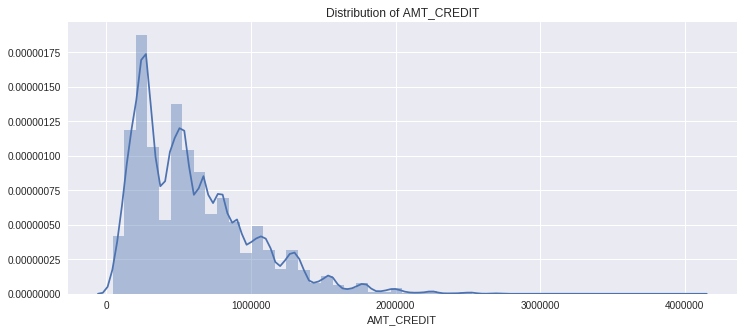

In [7]:
plt.figure(figsize=(12,5))
plt.title("Distribution of AMT_CREDIT")
ax=sns.distplot(df['AMT_CREDIT'])

In [8]:
configure_plotly_browser_state()
temp=df["TARGET"].value_counts()
temp.index=np.array(['Repaid','Defaulted'])
trace=go.Pie(labels=temp.index,values=temp.values)
iplot([trace])

In [9]:
configure_plotly_browser_state()
temp=df['NAME_CONTRACT_TYPE'].value_counts()
trace=go.Pie(title='Types of loan',values=temp.values,labels=temp.index,hole=0.6)
iplot([trace])

In [10]:
configure_plotly_browser_state()
fig={
    "data":[{
        "values":df['FLAG_OWN_REALTY'].value_counts().values,
        "labels":df['FLAG_OWN_REALTY'].value_counts().index,
        "domain":{"x":[0,0.48]},
        "name":"OWN REALTY",
        "hoverinfo":"label+percent+name",
        "hole":0.5,
        "type":"pie"
    },
    {
        "values":df['FLAG_OWN_CAR'].value_counts().values,
        "labels":df['FLAG_OWN_CAR'].value_counts().index,
        "domain":{"x":[0.52,1]},
        "name":"OWN CAR",
        "hoverinfo":"label+percent+name",
        "hole":0.5,
        "type":"pie"
    }],
    "layout":{
        "title":"Property of Applicants",
        "annotations":[
            {
                "font":{
                    "size":16
                },
                "text":"OWN REALTY",
                "showarrow":False,
                "x":0.19,
                "y":0.5
            },
            {
                "font":{
                    "size":16
                },
                "text":"OWN CAR",
                "showarrow":False,
                "x":0.795,
                "y":0.5
            }
    ]}
}
iplot(fig)